# Overview

This notebook visualizes cells from the following three datasets in a joint embedding space generated using Orthogroups.  
These data are used to generate interactive HTML plots using [Plotly](https://plotly.com/python/).

- sample ["Brain8"](https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSM3768152) from the [Jiang et al. 2021](https://www.frontiersin.org/articles/10.3389/fcell.2021.743421/full) zebrafish cell atlas
- sample ["Brain1"](https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSM2906405) from the [Han et al. 2018](https://www.sciencedirect.com/science/article/pii/S0092867418301168#sec4) mouse cell atlas
- sample ["Xenopus_brain_COL65"](https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSM6214268) from the [Liao et al. 2022](https://www.nature.com/articles/s41467-022-31949-2) Xenopus laevis adult cell atlas


# 0. Setup

Import packages and specify any important functions here.

In [1]:
# import standard python packages
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
import arcadia_pycolor as apc
import matplotlib as mpl
import plotly

apc.mpl_setup()

# 1. Load cell positions and labels in UMAP

In [2]:
df = pd.read_csv('DrerMmusXlae_adultbrain_OrthoFinder_plotlydata.tsv', sep = '\t')
df['leiden_str'] = df['leiden'].astype('str')
df.sort_values('leiden', inplace = True)
display(df)

,barcode,species,n_genes_by_counts,total_counts,n_genes,celltype,leiden,umap_1,umap_2,leiden_str
6638,Drer_TGATCATGTGCGACGAGC,Drer,110,270.0,110,Drer_Microglia,0,7.046144,-1.722527,0
2230,Drer_CCGACGAGGACTTATGTA,Drer,156,318.0,156,Drer_Microglia_apoc1_high,0,7.077815,-1.750230,0
6164,Drer_ATGCTTTTGGACGCAGGA,Drer,136,275.0,136,Drer_Macrophage,0,1.125388,3.780854,0
6161,Drer_TCACTTGCGAATCATGAT,Drer,114,235.0,114,Drer_Macrophage,0,6.194234,0.507093,0
6160,Drer_GAACGCCCGCTACTTCTG,Drer,125,254.0,125,Drer_Microglia,0,6.623922,-0.836812,0
...,...,...,...,...,...,...,...,...,...,...
291,Drer_ACGTTGCTGAAAACGAGC,Drer,216,649.0,216,Drer_Epithelial_cell_krt5_high,18,1.333266,-1.112021,18
194,Drer_CCGACGATACAGGCGTCC,Drer,192,657.0,192,Drer_Epithelial_cell_krt5_high,18,1.358813,-1.127639,18
6528,Drer_GTAATGTGAAGCACGAGC,Drer,115,183.0,115,Drer_Epithelial_cell_krt5_high,18,0.647171,0.673810,18
4485,Drer_ATTCCAATTCCACACAAG,Drer,124,293.0,124,Drer_Epithelial_cell_krt5_high,18,1.246256,-0.949170,18


# 2. Set up palette dictionaries

In [3]:
cluster_mapper = dict(zip([str(i) for i in sorted(df['leiden'].unique())], list(apc.Accent_all_ordered.values()) + [apc.Neutral['arcadia:crow']]))
species_mapper = {'Drer': apc.All['arcadia:aster'], 'Mmus': apc.All['arcadia:rose'], 'Xlae': apc.All['arcadia:seaweed']}
drer_celltype_palette = {
    # unlabeled, lightgrey
    'Unlabeled': apc.Core['arcadia:lightgrey'],
    
    # myeloid cells, dragon-tangerine-rose-amber
    'Erythrocyte': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:dragon'], 0.8)),
    'Innate_immune_cell': apc.Accent_all['arcadia:tangerine'],
    'Granulocyte': apc.Accent_all['arcadia:rose'],
    'Macrophage': apc.Accent_all['arcadia:amber'],
    'Macrophage_grn1_high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:dress'], 1)),
    
    # lymphoid cells, 
    'T_cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:marineblue'], 1)),
    
    # radial glia: lime-sage
    'Regenerating_Radial_gliacell': apc.Accent_all['arcadia:sage'],
    'Radial_glia': apc.Accent_all['arcadia:lime'],
    'Radial_glia_mdkb_high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:lime'], 0.6)),
    'Quiescent_Radial_gliacell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:lime'], 0.3)),
    
    # microglia, aster-periwinkle
    'Microglia': apc.Accent_all['arcadia:periwinkle'],
    'Microglia_apoc1_high': apc.Accent_all['arcadia:aster'],
    'Proliferating_cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:periwinkle'], 0.7)),
    
    # epithelial cells, aegean-wish-vitalblue
    'Epithelial_cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:aegean'], 0.8)),
    'Epithelial_cell_krt5_high': apc.Accent_all['arcadia:vitalblue'],
    'Meningeal_mural_lymphatic_endothelial_cell': apc.Accent_all['arcadia:bluesky'],
    
    # oligodendrocytes: chateau-taupe
    'Oligodendrocyte': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:chateau'], 0.7)),
    'Oligodendrocyte_sla_high': apc.Accent_all['arcadia:taupe'],
    
    # neuron: seaweed-mint-forest
    'Neuron': apc.Accent_all['arcadia:seaweed'],
    'Neuron_kiss_high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:seaweed'], 0.6)),
    'Neuroblast': mpl.colors.to_hex(apc.adjust_lightness(apc.Core['arcadia:forest'], 0.8)),
    'Neural_stem_cell': apc.Accent_all['arcadia:mint'],
    'Neural_progenitor_cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:sage'], 0.6))
}
mmus_celltype_palette = {
    # unlabeled, lightgrey
    'Unlabeled': apc.Core['arcadia:lightgrey'],
    
    'Macrophage_Lyz2 high': apc.Accent_all['arcadia:amber'],
    'Macrophage_Klf2 high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:dress'], 1)),

    'Myelinating oligodendrocyte': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:chateau'], 0.7)),
    'Oligodendrocyte precursor cell': apc.Accent_all['arcadia:taupe'],
    'Schwann cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:chateau'], 0.5)),
    
    'Neuron': apc.Accent_all['arcadia:seaweed'],
    'Pan-GABAergic': mpl.colors.to_hex(apc.adjust_lightness(apc.Core['arcadia:forest'], 1)),
    
    'Astrocyte_Atp1b2 high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:lime'], 1)),
    'Astrocyte_Mfe8 high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:lime'], 0.3)),
    'Astroglial cell(Bergman glia)': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:lime'], 0.6)),
    'Hypothalamic ependymal cell': apc.Accent_all['arcadia:sage'],
    
    'Microglia': apc.Accent_all['arcadia:periwinkle'],
}
xlae_celltype_palette = {
    # unlabeled, lightgrey
    'Unlabeled': apc.Core['arcadia:lightgrey'],
    
    # myeloid cells, dragon-tangerine-rose-amber
    'Erythrocyte': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:dragon'], 0.8)),
    'Proliferating myeloid cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:mars'], 1)),
    'Eosinophil': apc.Accent_all['arcadia:rose'],
    'Macrophage': apc.Accent_all['arcadia:amber'],
    'Mast cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:rose'], 0.3)),
    
    # lymphoid cells
    'Antigen-presenting cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:marineblue'], 0.7)),
    'T progenitor cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:denim'], 1)),
    'CD8+ T cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:marineblue'], 1)),
    'Plasma B cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:denim'], 0.5)),
    
    # endocrine cells
    'Growth hormone progenitor cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:wish'], 1)),
    'Growth hormone cell_hnrnpk high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:wish'], 0.8)),
    'Growth hormone cell_rasd1 high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:wish'], 0.6)),
    'Growth hormone cell_Rp high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:wish'], 0.4)),
    'Thyrotroph cell': apc.Neutral['arcadia:bark'],
    'Gonadotroph cell_cga high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:blossom'], 1)),
    'Gonadotroph cell_cyp21a2.1 high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:blossom'], 0.8)),
    'Endocrine progenitor cell_st6galnac2 high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:tangerine'], 0.7)),
    'Endocrine progenitor cell_chgb high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:tangerine'], 0.5)),
    'Melanotrope cell': apc.Neutral['arcadia:crow'],
    'Prolactin progenitor cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:canary'], 0.6)),
    
    # neuron: seaweed-mint-forest
    'Excitatory neuron_tac1 high': apc.Accent_all['arcadia:seaweed'],
    'Excitatory neuron_zbtb18 high': apc.Accent_all['arcadia:mint'],
    'Excitatory neuron_mex3a high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:seaweed'], 0.6)),
    'GABAergic neuron_tac1 high': mpl.colors.to_hex(apc.adjust_lightness(apc.Core['arcadia:forest'], 1)),
    'GABAergic neuron_scgn high': mpl.colors.to_hex(apc.adjust_lightness(apc.Core['arcadia:forest'], 1.1)),
    'GABAergic neuron_sst high': mpl.colors.to_hex(apc.adjust_lightness(apc.Core['arcadia:forest'], 1.2)),
    
    # oligodendrocytes: chateau-taupe
    'Myelinating oligodendrocyte progenitor cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:chateau'], 0.7)),
    'Oligodendrocyte precursor cell': apc.Accent_all['arcadia:taupe'],
    
    # astrocytes
    'Fibrous astrocyte': apc.Accent_all['arcadia:sage'],
    'Astrocyte_slc1a3 high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:lime'], 0.6)),
    'Astrocyte_adcyap1r1 high': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:lime'], 0.3)),
    'Radial glia': apc.Accent_all['arcadia:lime'],
    
    # endothelial cell
    'Capillary endothelial cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:bluesky'], 0.7)),
    'Endothelial cell': apc.Accent_all['arcadia:bluesky'],
    
    # other
    'Rp_high': apc.Accent_all['arcadia:oat'],
    'Rod photoreceptor':  apc.Accent_all['arcadia:canary'],
    
    # microglia
    'Microglia': apc.Accent_all['arcadia:periwinkle'],
    'Proliferating cell': mpl.colors.to_hex(apc.adjust_lightness(apc.Accent_all['arcadia:periwinkle'], 0.7)),
}

drer_celltype_palette_pre = {'Drer_' + key: value for key, value in drer_celltype_palette.items()}
mmus_celltype_palette_pre = {'Mmus_' + key: value for key, value in mmus_celltype_palette.items()}
xlae_celltype_palette_pre = {'Xlae_' + key: value for key, value in xlae_celltype_palette.items()}

celltype_mapper = drer_celltype_palette_pre | mmus_celltype_palette_pre | xlae_celltype_palette_pre | {'Unlabeled': apc.Core['arcadia:lightgrey']}

# 3. Generate switchable plot figure using plotly

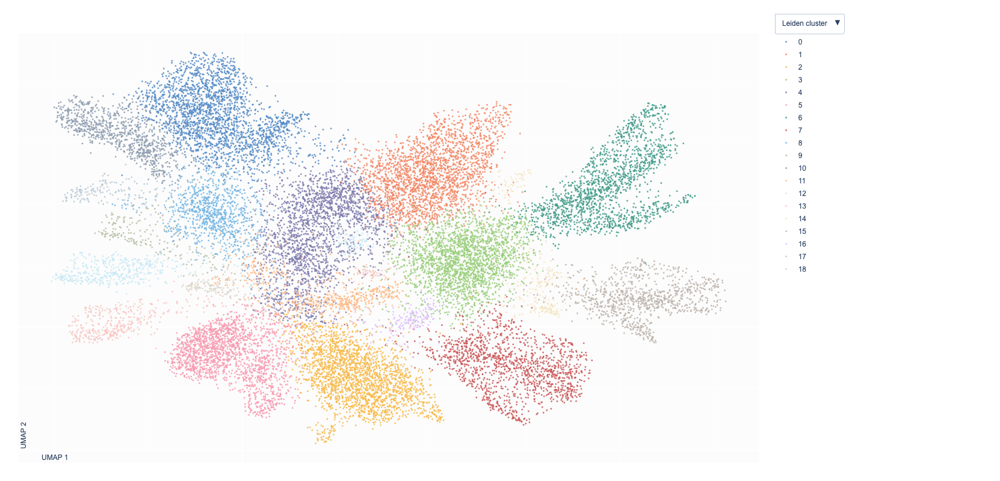

In [4]:
fig_params_dict = {
    'leiden_str': {
        'cmap': cluster_mapper,
        'textlabel': 'Leiden cluster',
        'showlegend': True
    },
    'species': {
        'cmap': species_mapper,
        'textlabel': 'Species',
        'showlegend': True
    },
    'celltype': {
        'cmap': celltype_mapper,
        'textlabel': 'Cell type',
        'showlegend': True
    }
}

customdata = ['barcode', 'leiden', 'celltype', 'species']

fig_dict = {}

for col, col_dict in fig_params_dict.items():
    temp_fig = px.scatter(df, 'umap_2', 'umap_1', color = df[col], 
                  color_discrete_map = col_dict['cmap'], custom_data = customdata)
    fig_dict[col] = temp_fig
    
fig = go.Figure()
for i, (col, plot) in enumerate(fig_dict.items()):
    visible = True if i == 0 else False
    
    for scatter in plot.data:
        if type(scatter) == plotly.graph_objs._scattergl.Scattergl:
            obj_method = go.Scattergl
        elif type(scatter) == plotly.graph_objs._scatter.Scatter:
            obj_method = go.Scatter
        
        showlegend = fig_params_dict[col]['showlegend']
        fig.add_trace(obj_method(scatter, visible = visible, marker_size = 3, marker_opacity = 0.8, showlegend = showlegend))

fig.update_traces(
    hovertemplate="<br>".join([
        "<b>Cell barcode:</b> %{customdata[0]}</br>", 
        "<b>Leiden cluster:</b> %{customdata[1]}", 
        "<b>Cell type:</b> %{customdata[2]}",
        "<extra></extra>"
    ])
)

button_layer_1_height = 1.06
fig.update_layout(
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=['visible', [True] * len(fig_dict['leiden_str'].data) + [False] * len(fig_dict['species'].data) + [False] * len(fig_dict['celltype'].data)],
                    label="Leiden cluster",
                    method="restyle"
                ),
                dict(
                    args=['visible', [False] * len(fig_dict['leiden_str'].data) + [True] * len(fig_dict['species'].data) + [False] * len(fig_dict['celltype'].data)],
                    label="Species",
                    method="restyle"
                ),
                dict(
                    args=['visible', [False] * len(fig_dict['leiden_str'].data) + [False] * len(fig_dict['species'].data) + [True] * len(fig_dict['celltype'].data)],
                    label="Cell type",
                    method="restyle"
                )
            ]),
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=1.02,
            xanchor="left",
            y=button_layer_1_height,
            yanchor="top"
        )
    ]
)

fig.update_layout(width = 1100, height = 800, plot_bgcolor = "#FCFCFC")
fig.update_layout(margin=dict(l=30, r=400, t=30, b=30))
fig.update_layout(legend=dict(yanchor="top", y = 1, tracegroupgap = 2))

xmin = df['umap_2'].min()
xmax = df['umap_2'].max()

xwiggle = 0.05 * (xmax - xmin)
ymin = df['umap_1'].min()
ymax = df['umap_1'].max()

ywiggle = 0.05 * (ymax - ymin)

fig.update_xaxes(showticklabels = False, range = (xmin - xwiggle, xmax + xwiggle), showspikes = True)
fig.update_yaxes(showticklabels = False, range = (ymin - ywiggle, ymax + ywiggle), showspikes = True)

fig.add_annotation(x = 0.03, y = 0, xref = "paper", yref = "paper", yanchor = 'bottom', showarrow = False, text="UMAP 1")
fig.add_annotation(x = 0, y = 0.03, xref = "paper", yref = "paper", xanchor = 'left', showarrow = False, text="UMAP 2", textangle = -90)

try:
    fig.update_layout(font=dict(family="Arial"))
except:
    pass

fig.write_html('figures/' + 'DrerMmusXlae_OG_plotly_revised.html')
        
fig.show()